In [206]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

df = pd.read_csv("../../../Divar.csv")

C:\Users\Rumi\AppData\Local\Temp\ipykernel_4272\2225313960.py:6: DtypeWarning: Columns (11,27,29,53) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("../../../Divar.csv")


<div <div dir="rtl" align="right">

 #### 1. توزیع آگهی‌های موجود در دسته‌های مختلف را برای دسته‌بندی سطح دو و سطح سه رسم کنید.
</div>

In [207]:
df.cat2_slug.value_counts()

cat2_slug
residential-sell        558708
residential-rent        276558
commercial-rent          76567
commercial-sell          38861
temporary-rent           29903
real-estate-services     19403
Name: count, dtype: int64

In [208]:
df.cat3_slug.value_counts()

cat3_slug
apartment-sell                        303385
apartment-rent                        211880
plot-old                              133570
house-villa-sell                      121753
house-villa-rent                       64678
shop-rent                              45993
shop-sell                              21855
office-rent                            21418
suite-apartment                        16465
presell                                15781
villa                                  12899
industry-agriculture-business-sell     11851
industry-agriculture-business-rent      9155
office-sell                             5155
partnership                             3622
workspace                                539
Name: count, dtype: int64

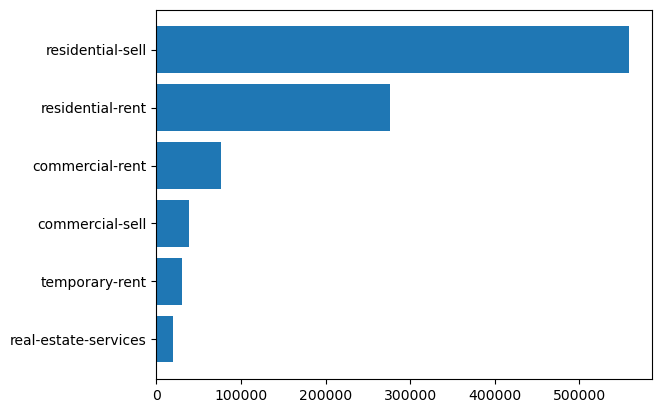

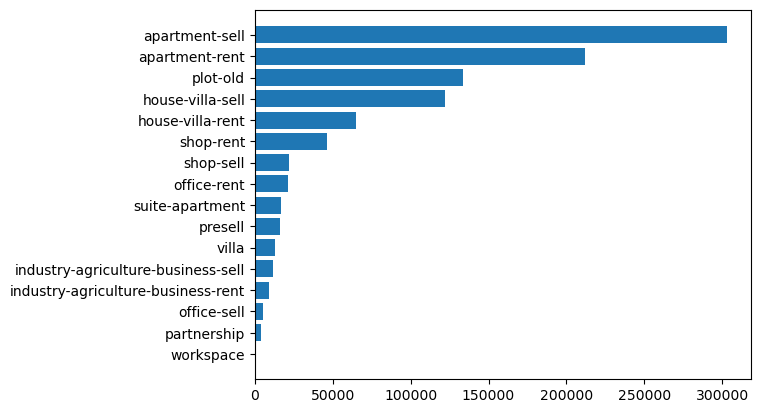

In [209]:
cat2_counts = df['cat2_slug'].value_counts(ascending = True)

plt.barh(cat2_counts.index , cat2_counts.values)
plt.show()

cat3_counts = df['cat3_slug'].value_counts(ascending = True)
plt.barh(cat3_counts.index , cat3_counts.values)
plt.show()

<div <div dir="rtl" align="right">

### تحلیل توزیع دسته‌بندی‌ها

* بازار املاک عمدتاً توسط **ملک‌های مسکونی** شکل گرفته است و بیشترین تعداد آگهی‌ها مربوط به آپارتمان‌ها می‌باشد.
* **فعالیت فروش بیش از اجاره** در هر دو دسته آپارتمان‌ها و خانه‌ها/ویلاها است.
* **آگهی‌های فروش ملک‌های تجاری کمتر از اجاره‌های آن‌ها** است؛ به‌طور مثال، تعداد آگهی‌های فروش دفتر کاری تقریبا یک‌چهارم آگهی‌های اجاره آن می‌باشد.
* **زمین/قطعه و فضاهای تجاری** بخش کوچکتر ولی قابل توجهی از آگهی‌ها را تشکیل می‌دهند.
* **دسته‌های کم‌تعداد و پراکنده** وجود دارد (مثل workspace و partnership) که ممکن است در مدلسازی نیاز به تجمیع داشته باشند.


    * “آپارتما‌ن‌ها حدود ~۶۱٪ از کل آگهی‌های مسکونی را تشکیل می‌دهند.”
    * “اجاره‌های موقت تنها ~۳٪ از کل بازار را شامل می‌شوند.”

</div>

<div <div dir="rtl" align="right">

#### 2.بر روی نقشه‌ی جغرافیایی heatmap آگهی‌های هر منطقه را رسم کنید. تراکم آگهی‌ها کدام منطقه بیشتر است؟
</div>

In [ ]:
import plotly.express as px
fig = px.density_map(df, lat='location_latitude', lon='location_longitude', radius=1,
                        center=dict(lat=32, lon=53), zoom=4, height=700, width= 700,
                        map_style="open-street-map")
fig.show()

<div <div dir="rtl" align="right">


### تحلیل نقشهٔ حرارتی آگهی‌ها

* بیشترین تراکم آگهی‌ها در **شمال ایران** مشاهده می‌شود، به‌ویژه مناطق تهران، البرز، گیلان و رشت.
* همچنین **کلان‌شهرها** دیگر نیز تراکم قابل توجهی دارند، اما کمتر از مناطق شمالی هستند.
* مناطق **جنوب و شرق ایران** دارای تراکم کمتری از آگهی‌ها هستند که نشان‌دهنده‌ی بازار کوچک‌تر یا تعداد کمتر آگهی‌ها در این مناطق است.
* تعداد بسیار کمی از آگهی‌ها در **کشورهای همسایه** مانند عراق، عربستان سعودی، سوریه و حتی ترکیه ثبت شده‌اند. این آگهی‌ها خیلی کم هستند و می‌توان آن‌ها را برای تحلیل بازار داخلی ایران نادیده گرفت.
* این تحلیل نشان می‌دهد که بازار املاک ایران عمدتاً حول **مناطق شهری و شمالی کشور** متمرکز است و برای هرگونه تحلیل یا مدلسازی تراکم، تمرکز بر این مناطق منطقی است.

</div>



<div <div dir="rtl" align="right">

#### 3.ترند میانگین قیمت اجاره بر حسب ماه‌های قرار گرفتن آگهی‌ها رسم کنید.(دقت کنید که ماه‌ها باید به تاریخ شمسی و خوانا باشند.)


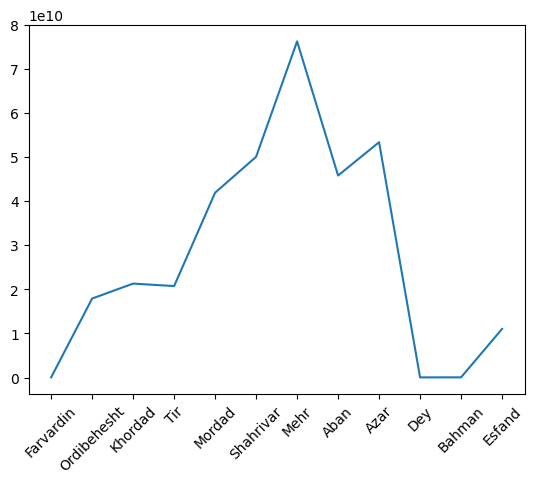

In [211]:
df1 = df.copy()
df1["created_at_month"] = df1["created_at_month"].astype("datetime64[ns]")
shamsi_months = ["Dey", "Bahman", "Esfand", "Farvardin", "Ordibehesht", "Khordad", "Tir", "Mordad", "Shahrivar", "Mehr", "Aban", "Azar"]
sorted_sm = ["Farvardin", "Ordibehesht", "Khordad", "Tir", "Mordad", "Shahrivar", "Mehr", "Aban", "Azar", "Dey", "Bahman", "Esfand"]
df1["shamsi_months"] = df1["created_at_month"].apply(lambda x : shamsi_months[x.month - 1])
    
grouped = df1.groupby(by="shamsi_months").agg({"rent_value" : "mean"}).reindex(sorted_sm)
plt.plot(grouped.index, grouped.values)
plt.xticks(rotation=45) 
plt.show()


با بررسی روند میانگین قیمت اجاره بر اساس ماه ثبت آگهی‌ها (بر مبنای تقویم شمسی)، مشخص شد که قیمت اجاره در طول سال دارای الگوی فصلی است. نتایج نشان می‌دهد که میانگین قیمت اجاره از ماه‌های ابتدایی سال به‌تدریج افزایش یافته و در ماه‌های شهریور و مهر به بیشترین مقدار خود می‌رسد. پس از این بازه، روند قیمت‌ها کاهش پیدا می‌کند و در ماه‌های زمستانی به کمترین مقدار می‌رسد.

این رفتار می‌تواند نشان‌دهنده افزایش تقاضا در اواخر تابستان و اوایل پاییز و کاهش فعالیت بازار اجاره در ماه‌های سرد سال باشد.

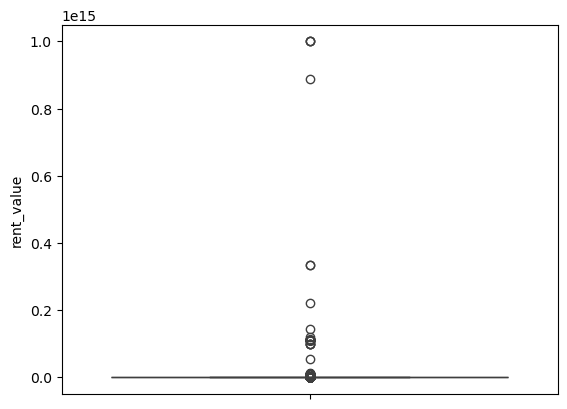

In [212]:
sns.boxplot(df1['rent_value'])
plt.show()

<div <div dir="rtl" align="right">

در ادامه بررسی داده‌ها، با رسم نمودار جعبه‌ای (Boxplot) برای متغیر rent_value مشاهده شد که داده‌های پرت بسیار شدیدی در سمت بالای توزیع وجود دارد. بررسی مقدار بیشینه این ستون نشان داد که مقدار
9999999999 به‌عنوان بیشترین مقدار ثبت شده است که از نظر منطقی با واقعیت بازار اجاره هم‌خوانی ندارد و به احتمال زیاد یک مقدار ساختگی یا پیش‌فرض سیستمی (Placeholder) برای قیمت‌های نامشخص یا توافقی است.

وجود چنین مقادیری باعث کشیده شدن توزیع داده‌ها و اختلال در تحلیل‌های آماری (مانند میانگین، واریانس و نمودارهای جعبه‌ای) می‌شود. بنابراین، این مقدار باید به‌عنوان داده‌ی نامعتبر در نظر گرفته شده و پیش از ادامه تحلیل‌ها، از مجموعه داده حذف یا اصلاح گردد تا نتایج به‌دست‌آمده معتبر و قابل اتکا باشند.

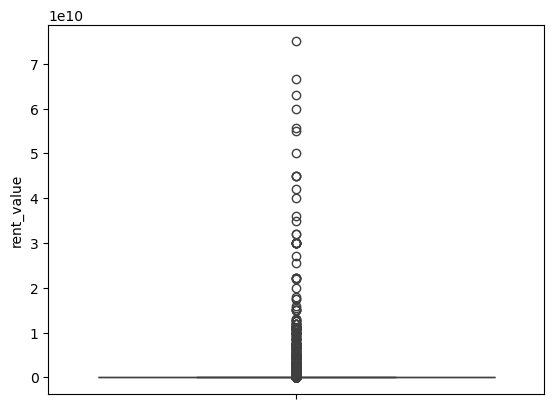

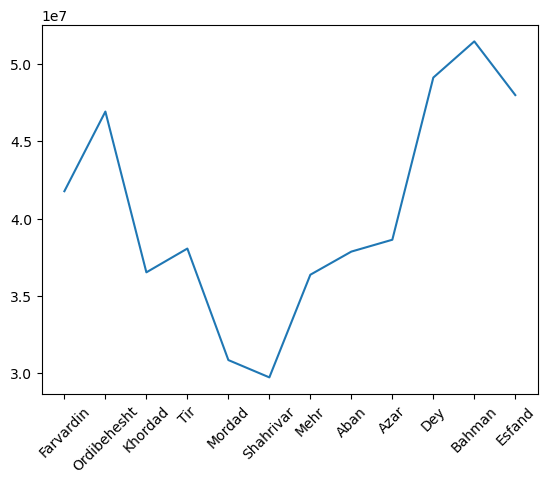

In [213]:
df1 = df1.sort_values(by="rent_value")
df1nn = df1.dropna(subset=['rent_value'])
df1nn = df1nn[df1nn["rent_value"] >= 1000000]
Q1 = np.percentile(df1nn["rent_value"], 25)
Q3 = np.percentile(df1nn["rent_value"],99.88)
IQR = Q3 - Q1
low_lim = Q1 - 1.5 * IQR
up_lim = Q3 + 1.5 * IQR
df1_noout = df1nn[(df1nn["rent_value"] < up_lim) & (df1nn["rent_value"] > low_lim)]
sns.boxplot(df1_noout['rent_value'])
plt.show()

grouped = df1_noout.groupby(by="shamsi_months").agg({"rent_value" : "mean"}).reindex(sorted_sm)
plt.plot(grouped.index, grouped.values)
plt.xticks(rotation=45) 
plt.show()

<div <div dir="rtl" align="right">

پس از شناسایی مقادیر غیرواقعی در ستون rent_value (مانند مقدار 9999999999 که به‌احتمال زیاد مقدار پیش‌فرض سیستمی بوده است)، داده‌ها با دقت بیشتری پالایش شدند. در این مرحله:

مقادیر اجاره‌ی بسیار کوچک و غیرمنطقی حذف شدند.

برای کنترل داده‌های پرت در سمت بالای توزیع، به‌جای چارک سوم کلاسیک، از صدک ۹۹٫۸۸ استفاده شد تا مقادیر بسیار افراطی حذف شوند، بدون آن‌که اجاره‌های بالا اما معتبر از تحلیل کنار گذاشته شوند.

پس از اعمال این فیلتر، بیشینه مقدار اجاره برابر با ۷۵ میلیارد ریال به‌دست آمد که نسبت به مقادیر قبلی، منطقی‌تر و قابل قبول‌تر به نظر می‌رسد.

تحلیل روند میانگین قیمت اجاره پس از پالایش داده‌ها نشان می‌دهد که:

قیمت اجاره در ماه‌های زمستانی (دی، بهمن و اسفند) در سطح بالاتری قرار دارد.

در مقابل، ماه‌های تابستانی به‌ویژه مرداد و شهریور کمترین میانگین قیمت اجاره را دارند.

این نتایج نشان می‌دهد که بخش قابل توجهی از الگوی مشاهده‌شده در تحلیل اولیه، تحت تأثیر داده‌های پرت بوده و پس از حذف آن‌ها، تصویر واقع‌بینانه‌تری از رفتار بازار اجاره به دست آمده است.

In [214]:
max_rent = df1_noout['rent_value'].max()
print(max_rent)
df1_noout[df1_noout["rent_value"] == max_rent]


75000000000.0


,Unnamed: 0,cat2_slug,cat3_slug,city_slug,neighborhood_slug,created_at_month,user_type,description,title,rent_mode,...,regular_person_capacity,extra_person_capacity,cost_per_extra_person,rent_price_on_regular_days,rent_price_on_special_days,rent_price_at_weekends,location_latitude,location_longitude,location_radius,shamsi_months
186389,186389,residential-rent,apartment-rent,tehran,qeytariyeh,2024-07-01,مشاور املاک,فرعی دنج با دسترسیهای عالی\n\nسازه ای خاص با م...,اپارتمان۲۲۰متر قیطریه مدرن و به روز,مقطوع,...,NaN,NaN,NaN,NaN,NaN,NaN,35.794792,51.448086,500.0,Tir


75,000,000,000 
عددی به نسبت منطقی تر بنظر میاد